In [2]:
import numpy as np
import pandas as pd
import os
import sklearn
import matplotlib.pyplot as plt
%matplotlib inline
from sklearn.model_selection import train_test_split, StratifiedKFold
from sklearn.metrics import f1_score,accuracy_score

In [3]:
!pip install -qq tqdm

In [4]:
!pip -qq install simpletransformers

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 315.5/315.5 kB 4.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 536.7/536.7 kB 9.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.6/43.6 kB 6.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 101.7/101.7 kB 10.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 18.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.4/8.4 MB 46.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 195.4/195.4 kB 20.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 258.5/258.5 kB 26.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 15.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 8.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.8/4.8 MB 47.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 83.0/83.0 kB 6.0 M

In [5]:
!pip -qq install catboost xgboost

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.5/98.5 MB 8.8 MB/s eta 0:00:00


In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [9]:
#model paths
tbert="/content/drive/MyDrive/Capstone/Models/Tamil/tbert_tamil.sav"
xlm="/content/drive/MyDrive/Capstone/Models/Tamil/xlm_roberta_tamil.sav"
distilbert="/content/drive/MyDrive/Capstone/Models/Tamil/distilbert_tamil.sav"
muril="/content/drive/MyDrive/Capstone/Models/Tamil/muril_tamil.sav"
mbert="/content/drive/MyDrive/Capstone/Models/Tamil/mbert_tamil.sav"
tamillion="/content/drive/MyDrive/Capstone/Models/Tamil/tamillion_tamil.sav"

In [10]:
import pickle
tbert_model=pickle.load(open(tbert,'rb'))
#xlm_model=pickle.load(open(xlm,'rb'))
#mbert_model=pickle.load(open(mbert,'rb'))
#distilbert_model=pickle.load(open(distilbert,'rb'))
muril_model=pickle.load(open(muril,'rb'))
#tamillion_model=pickle.load(open(tamillion,'rb'))

In [7]:
colab_sample_data_path = '/content/sample_data'
os.chdir(colab_sample_data_path)

## Preprocessing the dataset (text to numerical feature vector)

In [8]:
from IPython.display import clear_output
from tqdm import tqdm
import numpy as np

def preprocess_dataset(df, model, training, batch_size):
    processed_text, labels = [], []
    problematic_inputs = []

    total_batches = (len(df) + batch_size - 1) // batch_size
    for i in tqdm(range(0, len(df), batch_size), total=total_batches, desc="Processing Data"):
        batch_texts = df['text'].iloc[i:i+batch_size].tolist()
        batch_labels = df['label'].iloc[i:i+batch_size].tolist()

        # Ensure batch_texts is a list of texts
        if not isinstance(batch_texts, list):
            batch_texts = [batch_texts]

        try:
            # Use batch processing for predictions
            batch_predictions = model.predict(batch_texts)
            processed_text.extend(batch_predictions[1])  # processed text
            labels.extend(batch_labels)
        except Exception as e:
            print(f"Error occurred during prediction: {e}")
            problematic_inputs.extend(batch_texts)

        clear_output(wait=True)

    #print("\nInputs causing the error:")
    #print(problematic_inputs)

    return np.array(processed_text), np.array(labels)


In [11]:
dataset=pd.read_csv("/content/drive/MyDrive/Capstone/Dataset/Preprocessed/tamil_dataset_2_train.csv")
X=list(dataset['text'])
y=list(dataset['label'])
X_train, X_test, y_train, y_test = train_test_split(X, y , random_state=42,test_size=0.30)
train_df = pd.DataFrame({"text": X_train, "label": y_train})
test_df = pd.DataFrame({"text": X_test, "label": y_test})

### TBERT Ensemble models for tamil text

In [25]:
 #get the features vector and their labels (training set)
X_train,y_train=preprocess_dataset(train_df,
                                   model=tbert_model,
                                   training=True,
                                   batch_size=128)

Processing Data: 100%|██████████| 231/231 [05:38<00:00,  1.47s/it]


In [26]:
#get the features vector and their labels (testing set)
X_test,y_test=preprocess_dataset(test_df,
                                 model=tbert_model,
                                 training=False,
                                 batch_size=128)

Processing Data: 100%|██████████| 99/99 [02:28<00:00,  1.50s/it]


#### SVM

In [27]:
from sklearn.svm import SVC
from sklearn.metrics import classification_report, confusion_matrix
svm_classifier = SVC(kernel='rbf', random_state=42)
svm_classifier.fit(X_train, y_train)
pred_svm = svm_classifier.predict(X_test)
print(classification_report(y_test, pred_svm))
print(confusion_matrix(y_test, pred_svm))

              precision    recall  f1-score   support

           0       0.88      0.91      0.89      9577
           1       0.68      0.61      0.64      3063

    accuracy                           0.83     12640
   macro avg       0.78      0.76      0.77     12640
weighted avg       0.83      0.83      0.83     12640

[[8676  901]
 [1190 1873]]


#### Decision tree

In [28]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import classification_report,confusion_matrix
clf=DecisionTreeClassifier(criterion='entropy',random_state=42)
clf.fit(X_train,y_train)
pred_dtc=clf.predict(X_test)
print(classification_report(pred_dtc,y_test))
print(confusion_matrix(pred_dtc,y_test))

              precision    recall  f1-score   support

           0       0.90      0.88      0.89      9787
           1       0.61      0.66      0.64      2853

    accuracy                           0.83     12640
   macro avg       0.76      0.77      0.76     12640
weighted avg       0.83      0.83      0.83     12640

[[8604 1183]
 [ 973 1880]]


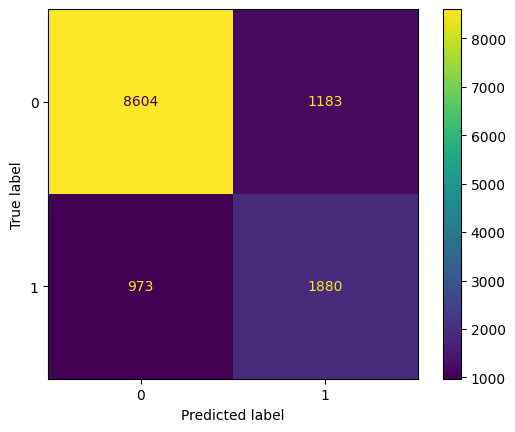

In [29]:
from sklearn.metrics import ConfusionMatrixDisplay
fig=ConfusionMatrixDisplay(confusion_matrix=confusion_matrix(pred_dtc,y_test),display_labels=clf.classes_)
fig.plot()

#### Random forest

In [30]:
from sklearn.ensemble import RandomForestClassifier
rfc = RandomForestClassifier(n_estimators=10,criterion='entropy',random_state=42)
rfc.fit(X_train,y_train)
pred_rfc = rfc.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

              precision    recall  f1-score   support

           0       0.88      0.90      0.89      9577
           1       0.67      0.61      0.64      3063

    accuracy                           0.83     12640
   macro avg       0.77      0.76      0.77     12640
weighted avg       0.83      0.83      0.83     12640

[[8651  926]
 [1186 1877]]


In [31]:
#find the best tree value
error_rate = []

for i in range(1,40):
    rfc = RandomForestClassifier(n_estimators=i,criterion='entropy',random_state=42)
    rfc.fit(X_train,y_train)
    pred_i = rfc.predict(X_test)
    error_rate.append(np.mean(pred_i != y_test))

Text(0, 0.5, 'Error Rate')

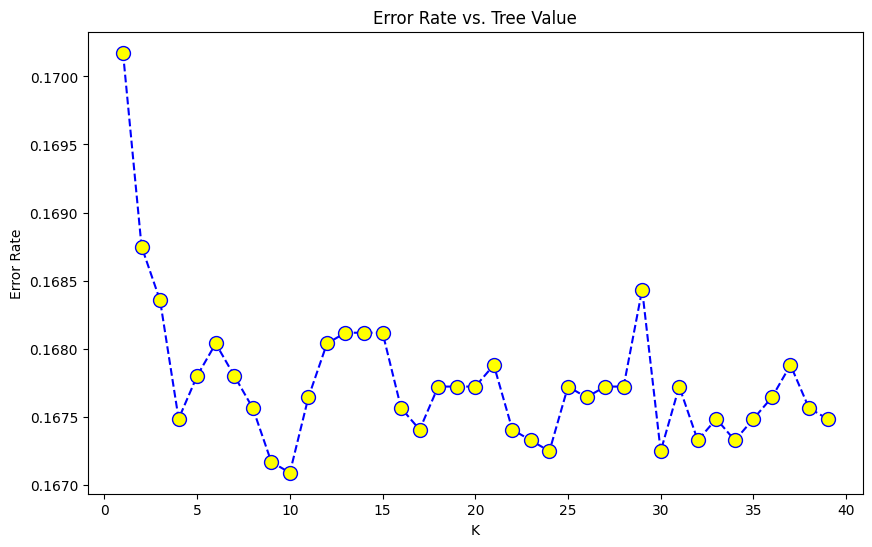

In [32]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10,6))
plt.plot(range(1,40),error_rate,color='blue', linestyle='dashed', marker='o',
         markerfacecolor='yellow', markersize=10)
plt.title('Error Rate vs. Tree Value')
plt.xlabel('K')
plt.ylabel('Error Rate') #error rate decrease as the tree value increases

In [33]:
rfc = RandomForestClassifier(n_estimators=5,criterion='entropy',random_state=42) #12- trees from elbow method
rfc.fit(X_train,y_train)
pred_rfc= rfc.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

              precision    recall  f1-score   support

           0       0.88      0.90      0.89      9577
           1       0.67      0.62      0.64      3063

    accuracy                           0.83     12640
   macro avg       0.77      0.76      0.77     12640
weighted avg       0.83      0.83      0.83     12640

[[8634  943]
 [1178 1885]]


#### Xgboost classifier

In [34]:
from xgboost import XGBClassifier
classifier=XGBClassifier()
classifier.fit(X_train,y_train)
pred_xgb= classifier.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

              precision    recall  f1-score   support

           0       0.88      0.90      0.89      9577
           1       0.67      0.62      0.64      3063

    accuracy                           0.83     12640
   macro avg       0.77      0.76      0.77     12640
weighted avg       0.83      0.83      0.83     12640

[[8634  943]
 [1178 1885]]


In [35]:
from xgboost import XGBClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report, confusion_matrix

# Define the XGBoost classifier
classifier = XGBClassifier()

# Define the parameter grid for hyperparameter tuning
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [3, 5, 7],
    'learning_rate': [0.01, 0.05, 0.1]
}

# Perform grid search cross-validation
grid_search = GridSearchCV(estimator=classifier, param_grid=param_grid, cv=3, scoring='accuracy', verbose=2, n_jobs=-1)

# Fit the grid search to the data
grid_search.fit(X_train, y_train)

# Get the best model
best_classifier = grid_search.best_estimator_

# Make predictions with the best model
pred_xgb = best_classifier.predict(X_test)

# Print classification report and confusion matrix
print("Classification Report:")
print(classification_report(y_test, pred_xgb))
print("Confusion Matrix:")
print(confusion_matrix(y_test, pred_xgb))

# Print the best parameters found
print("Best Parameters:", grid_search.best_params_)


Fitting 3 folds for each of 27 candidates, totalling 81 fits
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.90      0.89      9577
           1       0.67      0.62      0.64      3063

    accuracy                           0.83     12640
   macro avg       0.78      0.76      0.77     12640
weighted avg       0.83      0.83      0.83     12640

Confusion Matrix:
[[8659  918]
 [1176 1887]]
Best Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 100}


#### Catboost classifier

In [36]:
from catboost import CatBoostClassifier
classifier=CatBoostClassifier()
classifier.fit(X_train,y_train)
pred_xgb= classifier.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

Learning rate set to 0.043621
0:	learn: 0.5912824	total: 7.21ms	remaining: 7.2s
1:	learn: 0.5075140	total: 13.7ms	remaining: 6.86s
2:	learn: 0.4333653	total: 21.2ms	remaining: 7.04s
3:	learn: 0.3728778	total: 27.3ms	remaining: 6.79s
4:	learn: 0.3226929	total: 33.6ms	remaining: 6.68s
5:	learn: 0.2784487	total: 40.1ms	remaining: 6.64s
6:	learn: 0.2419651	total: 46ms	remaining: 6.53s
7:	learn: 0.2122806	total: 53.1ms	remaining: 6.58s
8:	learn: 0.1874871	total: 59.6ms	remaining: 6.56s
9:	learn: 0.1677476	total: 65.7ms	remaining: 6.5s
10:	learn: 0.1503536	total: 71.9ms	remaining: 6.46s
11:	learn: 0.1355665	total: 78.5ms	remaining: 6.46s
12:	learn: 0.1230035	total: 84.7ms	remaining: 6.43s
13:	learn: 0.1121144	total: 91.1ms	remaining: 6.41s
14:	learn: 0.1026286	total: 97.8ms	remaining: 6.42s
15:	learn: 0.0949384	total: 107ms	remaining: 6.56s
16:	learn: 0.0882504	total: 112ms	remaining: 6.5s
17:	learn: 0.0827481	total: 118ms	remaining: 6.46s
18:	learn: 0.0779811	total: 125ms	remaining: 6.44s
1

In [37]:
from catboost import CatBoostClassifier
from sklearn.model_selection import GridSearchCV, StratifiedKFold
from sklearn.metrics import classification_report, confusion_matrix

# Define the CatBoost classifier
classifier = CatBoostClassifier()

# Define the parameter grid for hyperparameter tuning
param_grid = {
    'iterations': [100, 200],
    'depth': [3, 5],
    'learning_rate': [0.05, 0.1]
}

# Define stratified k-fold cross-validation
cv = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)

# Perform grid search cross-validation with early stopping
grid_search = GridSearchCV(estimator=classifier, param_grid=param_grid, cv=cv, scoring='accuracy', verbose=2, n_jobs=-1)

# Fit the grid search to the data with early stopping
grid_search.fit(X_train, y_train, early_stopping_rounds=10, eval_set=(X_test, y_test), verbose=False)

# Get the best model
best_classifier = grid_search.best_estimator_

# Make predictions with the best model
pred_catboost = best_classifier.predict(X_test)

# Print classification report and confusion matrix
print("Classification Report:")
print(classification_report(y_test, pred_catboost))
print("Confusion Matrix:")
print(confusion_matrix(y_test, pred_catboost))

# Print the best parameters found
print("Best Parameters:", grid_search.best_params_)


Fitting 3 folds for each of 8 candidates, totalling 24 fits
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.90      0.89      9577
           1       0.67      0.62      0.64      3063

    accuracy                           0.83     12640
   macro avg       0.78      0.76      0.77     12640
weighted avg       0.83      0.83      0.83     12640

Confusion Matrix:
[[8659  918]
 [1177 1886]]
Best Parameters: {'depth': 5, 'iterations': 100, 'learning_rate': 0.05}


### XLM_RoBERTa Ensemble models for tamil text

In [ ]:
 #get the features vector and their labels (training set)
X_train,y_train=preprocess_dataset(train_df,
                                   model=xlm_model,
                                   training=True,
                                   batch_size=128)

Processing Data: 100%|██████████| 231/231 [08:34<00:00,  2.23s/it]


In [ ]:
#get the features vector and their labels (testing set)
X_test,y_test=preprocess_dataset(test_df,
                                 model=xlm_model,
                                 training=False,
                                 batch_size=128)

Processing Data: 100%|██████████| 99/99 [03:44<00:00,  2.27s/it]


#### SVM

In [ ]:
from sklearn.svm import SVC
from sklearn.metrics import classification_report, confusion_matrix
svm_classifier = SVC(kernel='rbf', random_state=42)
svm_classifier.fit(X_train, y_train)
pred_svm = svm_classifier.predict(X_test)
print(classification_report(y_test, pred_svm))
print(confusion_matrix(y_test, pred_svm))

              precision    recall  f1-score   support

           0       0.88      0.90      0.89      9577
           1       0.66      0.63      0.65      3063

    accuracy                           0.83     12640
   macro avg       0.77      0.76      0.77     12640
weighted avg       0.83      0.83      0.83     12640

[[8577 1000]
 [1125 1938]]


#### Decision tree

In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import classification_report,confusion_matrix
clf=DecisionTreeClassifier(criterion='entropy',random_state=42)
clf.fit(X_train,y_train)
pred_dtc=clf.predict(X_test)
print(classification_report(pred_dtc,y_test))
print(confusion_matrix(pred_dtc,y_test))

              precision    recall  f1-score   support

           0       0.89      0.88      0.89      9704
           1       0.62      0.64      0.63      2936

    accuracy                           0.82     12640
   macro avg       0.75      0.76      0.76     12640
weighted avg       0.83      0.82      0.83     12640

[[8534 1170]
 [1043 1893]]


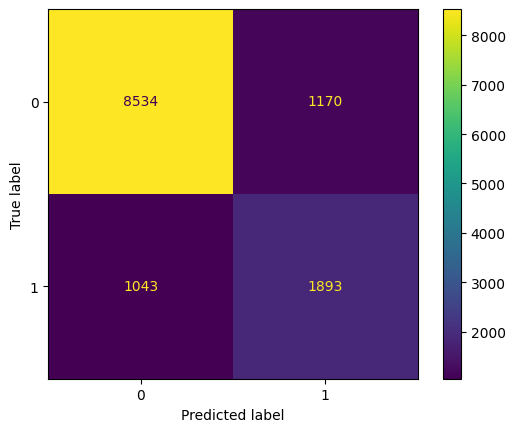

In [ ]:
from sklearn.metrics import ConfusionMatrixDisplay
fig=ConfusionMatrixDisplay(confusion_matrix=confusion_matrix(pred_dtc,y_test),display_labels=clf.classes_)
fig.plot()

#### Random forest

In [ ]:
from sklearn.ensemble import RandomForestClassifier
rfc = RandomForestClassifier(n_estimators=10,criterion='entropy',random_state=42)
rfc.fit(X_train,y_train)
pred_rfc = rfc.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

              precision    recall  f1-score   support

           0       0.88      0.90      0.89      9577
           1       0.66      0.62      0.64      3063

    accuracy                           0.83     12640
   macro avg       0.77      0.76      0.76     12640
weighted avg       0.83      0.83      0.83     12640

[[8604  973]
 [1167 1896]]


In [ ]:
#find the best tree value
error_rate = []

for i in range(1,40):
    rfc = RandomForestClassifier(n_estimators=i,criterion='entropy',random_state=42)
    rfc.fit(X_train,y_train)
    pred_i = rfc.predict(X_test)
    error_rate.append(np.mean(pred_i != y_test))

Text(0, 0.5, 'Error Rate')

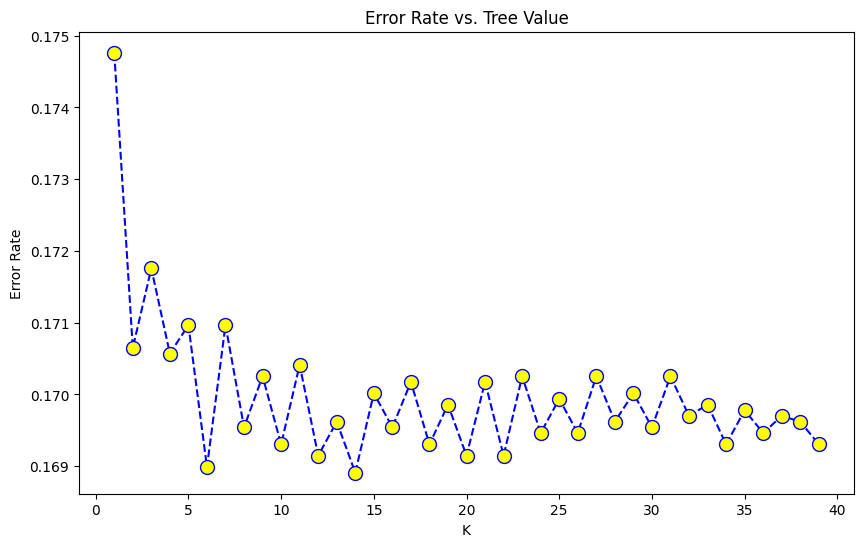

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10,6))
plt.plot(range(1,40),error_rate,color='blue', linestyle='dashed', marker='o',
         markerfacecolor='yellow', markersize=10)
plt.title('Error Rate vs. Tree Value')
plt.xlabel('K')
plt.ylabel('Error Rate') #error rate decrease as the tree value increases

In [ ]:
rfc = RandomForestClassifier(n_estimators=5,criterion='entropy',random_state=42) #12- trees from elbow method
rfc.fit(X_train,y_train)
pred_rfc= rfc.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

              precision    recall  f1-score   support

           0       0.88      0.89      0.89      9577
           1       0.65      0.63      0.64      3063

    accuracy                           0.83     12640
   macro avg       0.77      0.76      0.76     12640
weighted avg       0.83      0.83      0.83     12640

[[8554 1023]
 [1138 1925]]


#### Xgboost classifier

In [ ]:
from xgboost import XGBClassifier
classifier=XGBClassifier()
classifier.fit(X_train,y_train)
pred_xgb= classifier.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

              precision    recall  f1-score   support

           0       0.88      0.89      0.89      9577
           1       0.65      0.63      0.64      3063

    accuracy                           0.83     12640
   macro avg       0.77      0.76      0.76     12640
weighted avg       0.83      0.83      0.83     12640

[[8554 1023]
 [1138 1925]]


In [ ]:
from xgboost import XGBClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report, confusion_matrix

# Define the XGBoost classifier
classifier = XGBClassifier()

# Define the parameter grid for hyperparameter tuning
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [3, 5, 7],
    'learning_rate': [0.01, 0.05, 0.1]
}

# Perform grid search cross-validation
grid_search = GridSearchCV(estimator=classifier, param_grid=param_grid, cv=3, scoring='accuracy', verbose=2, n_jobs=-1)

# Fit the grid search to the data
grid_search.fit(X_train, y_train)

# Get the best model
best_classifier = grid_search.best_estimator_

# Make predictions with the best model
pred_xgb = best_classifier.predict(X_test)

# Print classification report and confusion matrix
print("Classification Report:")
print(classification_report(y_test, pred_xgb))
print("Confusion Matrix:")
print(confusion_matrix(y_test, pred_xgb))

# Print the best parameters found
print("Best Parameters:", grid_search.best_params_)


Fitting 3 folds for each of 27 candidates, totalling 81 fits
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.90      0.89      9577
           1       0.66      0.63      0.64      3063

    accuracy                           0.83     12640
   macro avg       0.77      0.76      0.77     12640
weighted avg       0.83      0.83      0.83     12640

Confusion Matrix:
[[8596  981]
 [1141 1922]]
Best Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 300}


#### Catboost classifier

In [ ]:
from catboost import CatBoostClassifier
classifier=CatBoostClassifier()
classifier.fit(X_train,y_train)
pred_xgb= classifier.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

Learning rate set to 0.043621
0:	learn: 0.5946955	total: 7.03ms	remaining: 7.03s
1:	learn: 0.5088189	total: 13.3ms	remaining: 6.64s
2:	learn: 0.4424891	total: 19.4ms	remaining: 6.45s
3:	learn: 0.3859606	total: 25.7ms	remaining: 6.41s
4:	learn: 0.3372729	total: 31.7ms	remaining: 6.31s
5:	learn: 0.2954812	total: 37.9ms	remaining: 6.28s
6:	learn: 0.2626333	total: 44.1ms	remaining: 6.25s
7:	learn: 0.2343214	total: 50.3ms	remaining: 6.23s
8:	learn: 0.2101347	total: 56.4ms	remaining: 6.21s
9:	learn: 0.1907890	total: 63ms	remaining: 6.24s
10:	learn: 0.1741282	total: 69.2ms	remaining: 6.22s
11:	learn: 0.1614666	total: 75.4ms	remaining: 6.21s
12:	learn: 0.1498089	total: 81.6ms	remaining: 6.2s
13:	learn: 0.1389466	total: 87.3ms	remaining: 6.14s
14:	learn: 0.1294849	total: 93.5ms	remaining: 6.14s
15:	learn: 0.1221621	total: 99.7ms	remaining: 6.13s
16:	learn: 0.1153361	total: 106ms	remaining: 6.11s
17:	learn: 0.1092496	total: 112ms	remaining: 6.12s
18:	learn: 0.1042385	total: 119ms	remaining: 6.13

In [ ]:
from catboost import CatBoostClassifier
from sklearn.model_selection import GridSearchCV, StratifiedKFold
from sklearn.metrics import classification_report, confusion_matrix

# Define the CatBoost classifier
classifier = CatBoostClassifier()

# Define the parameter grid for hyperparameter tuning
param_grid = {
    'iterations': [100, 200],
    'depth': [3, 5],
    'learning_rate': [0.05, 0.1]
}

# Define stratified k-fold cross-validation
cv = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)

# Perform grid search cross-validation with early stopping
grid_search = GridSearchCV(estimator=classifier, param_grid=param_grid, cv=cv, scoring='accuracy', verbose=2, n_jobs=-1)

# Fit the grid search to the data with early stopping
grid_search.fit(X_train, y_train, early_stopping_rounds=10, eval_set=(X_test, y_test), verbose=False)

# Get the best model
best_classifier = grid_search.best_estimator_

# Make predictions with the best model
pred_catboost = best_classifier.predict(X_test)

# Print classification report and confusion matrix
print("Classification Report:")
print(classification_report(y_test, pred_catboost))
print("Confusion Matrix:")
print(confusion_matrix(y_test, pred_catboost))

# Print the best parameters found
print("Best Parameters:", grid_search.best_params_)


Fitting 3 folds for each of 8 candidates, totalling 24 fits
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.90      0.89      9577
           1       0.66      0.62      0.64      3063

    accuracy                           0.83     12640
   macro avg       0.77      0.76      0.77     12640
weighted avg       0.83      0.83      0.83     12640

Confusion Matrix:
[[8604  973]
 [1151 1912]]
Best Parameters: {'depth': 3, 'iterations': 100, 'learning_rate': 0.05}


### DistilBERT Ensemble models for tamil text

In [ ]:
 #get the features vector and their labels (training set)
X_train,y_train=preprocess_dataset(train_df,
                                   model=distilbert_model,
                                   training=True,
                                   batch_size=128)

Processing Data: 100%|██████████| 231/231 [05:55<00:00,  1.54s/it]


In [ ]:
#get the features vector and their labels (testing set)
X_test,y_test=preprocess_dataset(test_df,
                                 model=distilbert_model,
                                 training=False,
                                 batch_size=128)

Processing Data: 100%|██████████| 99/99 [02:33<00:00,  1.55s/it]


#### SVM

In [ ]:
from sklearn.svm import SVC
from sklearn.metrics import classification_report, confusion_matrix
svm_classifier = SVC(kernel='rbf', random_state=42)
svm_classifier.fit(X_train, y_train)
pred_svm = svm_classifier.predict(X_test)
print(classification_report(y_test, pred_svm))
print(confusion_matrix(y_test, pred_svm))

              precision    recall  f1-score   support

           0       0.87      0.89      0.88      9577
           1       0.64      0.58      0.61      3063

    accuracy                           0.82     12640
   macro avg       0.75      0.74      0.74     12640
weighted avg       0.81      0.82      0.81     12640

[[8558 1019]
 [1287 1776]]


#### Decision tree

In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import classification_report,confusion_matrix
clf=DecisionTreeClassifier(criterion='entropy',random_state=42)
clf.fit(X_train,y_train)
pred_dtc=clf.predict(X_test)
print(classification_report(pred_dtc,y_test))
print(confusion_matrix(pred_dtc,y_test))

              precision    recall  f1-score   support

           0       0.87      0.87      0.87      9620
           1       0.58      0.59      0.59      3020

    accuracy                           0.80     12640
   macro avg       0.73      0.73      0.73     12640
weighted avg       0.80      0.80      0.80     12640

[[8344 1276]
 [1233 1787]]


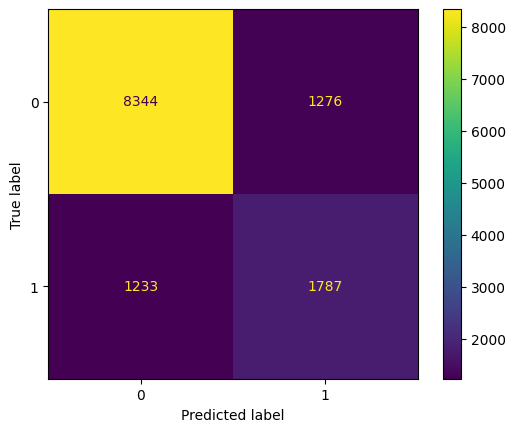

In [ ]:
from sklearn.metrics import ConfusionMatrixDisplay
fig=ConfusionMatrixDisplay(confusion_matrix=confusion_matrix(pred_dtc,y_test),display_labels=clf.classes_)
fig.plot()

#### Random forest

In [ ]:
from sklearn.ensemble import RandomForestClassifier
rfc = RandomForestClassifier(n_estimators=10,criterion='entropy',random_state=42)
rfc.fit(X_train,y_train)
pred_rfc = rfc.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

              precision    recall  f1-score   support

           0       0.86      0.89      0.88      9577
           1       0.62      0.56      0.59      3063

    accuracy                           0.81     12640
   macro avg       0.74      0.73      0.73     12640
weighted avg       0.81      0.81      0.81     12640

[[8536 1041]
 [1340 1723]]


In [ ]:
#find the best tree value
error_rate = []

for i in range(1,40):
    rfc = RandomForestClassifier(n_estimators=i,criterion='entropy',random_state=42)
    rfc.fit(X_train,y_train)
    pred_i = rfc.predict(X_test)
    error_rate.append(np.mean(pred_i != y_test))

Text(0, 0.5, 'Error Rate')

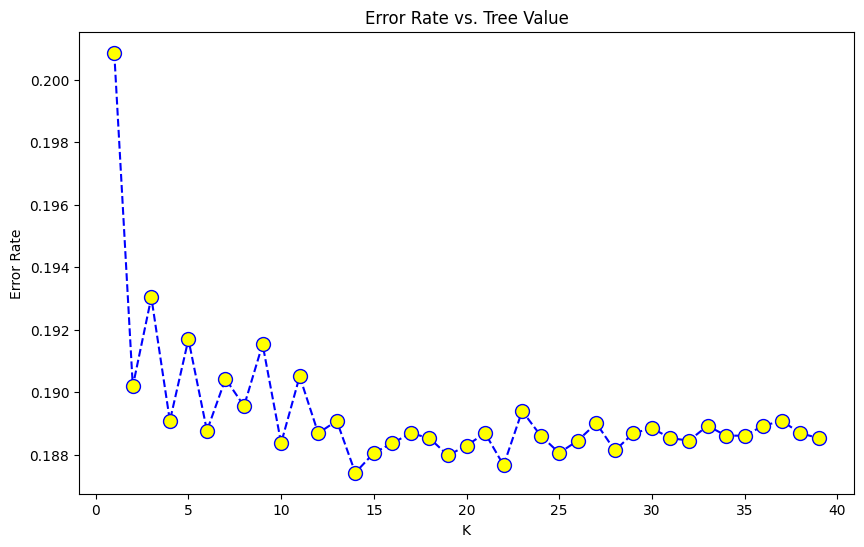

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10,6))
plt.plot(range(1,40),error_rate,color='blue', linestyle='dashed', marker='o',
         markerfacecolor='yellow', markersize=10)
plt.title('Error Rate vs. Tree Value')
plt.xlabel('K')
plt.ylabel('Error Rate') #error rate decrease as the tree value increases

In [ ]:
rfc = RandomForestClassifier(n_estimators=5,criterion='entropy',random_state=42) #12- trees from elbow method
rfc.fit(X_train,y_train)
pred_rfc= rfc.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

              precision    recall  f1-score   support

           0       0.87      0.88      0.87      9577
           1       0.61      0.58      0.59      3063

    accuracy                           0.81     12640
   macro avg       0.74      0.73      0.73     12640
weighted avg       0.81      0.81      0.81     12640

[[8442 1135]
 [1288 1775]]


#### Xgboost classifier

In [ ]:
from xgboost import XGBClassifier
classifier=XGBClassifier()
classifier.fit(X_train,y_train)
pred_xgb= classifier.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

              precision    recall  f1-score   support

           0       0.87      0.88      0.87      9577
           1       0.61      0.58      0.59      3063

    accuracy                           0.81     12640
   macro avg       0.74      0.73      0.73     12640
weighted avg       0.81      0.81      0.81     12640

[[8442 1135]
 [1288 1775]]


In [ ]:
from xgboost import XGBClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report, confusion_matrix

# Define the XGBoost classifier
classifier = XGBClassifier()

# Define the parameter grid for hyperparameter tuning
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [3, 5, 7],
    'learning_rate': [0.01, 0.05, 0.1]
}

# Perform grid search cross-validation
grid_search = GridSearchCV(estimator=classifier, param_grid=param_grid, cv=3, scoring='accuracy', verbose=2, n_jobs=-1)

# Fit the grid search to the data
grid_search.fit(X_train, y_train)

# Get the best model
best_classifier = grid_search.best_estimator_

# Make predictions with the best model
pred_xgb = best_classifier.predict(X_test)

# Print classification report and confusion matrix
print("Classification Report:")
print(classification_report(y_test, pred_xgb))
print("Confusion Matrix:")
print(confusion_matrix(y_test, pred_xgb))

# Print the best parameters found
print("Best Parameters:", grid_search.best_params_)


Fitting 3 folds for each of 27 candidates, totalling 81 fits
Classification Report:
              precision    recall  f1-score   support

           0       0.87      0.89      0.88      9577
           1       0.63      0.59      0.61      3063

    accuracy                           0.82     12640
   macro avg       0.75      0.74      0.74     12640
weighted avg       0.81      0.82      0.81     12640

Confusion Matrix:
[[8520 1057]
 [1263 1800]]
Best Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 300}


#### Catboost classifier

In [ ]:
from catboost import CatBoostClassifier
classifier=CatBoostClassifier()
classifier.fit(X_train,y_train)
pred_xgb= classifier.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

Learning rate set to 0.043621
0:	learn: 0.6139580	total: 7.02ms	remaining: 7.01s
1:	learn: 0.5462541	total: 13.1ms	remaining: 6.56s
2:	learn: 0.4926143	total: 18.9ms	remaining: 6.27s
3:	learn: 0.4456621	total: 24.9ms	remaining: 6.19s
4:	learn: 0.4038262	total: 31.4ms	remaining: 6.25s
5:	learn: 0.3702186	total: 37.9ms	remaining: 6.27s
6:	learn: 0.3408663	total: 43.7ms	remaining: 6.19s
7:	learn: 0.3177302	total: 49.8ms	remaining: 6.18s
8:	learn: 0.2977479	total: 56.4ms	remaining: 6.21s
9:	learn: 0.2812295	total: 63.3ms	remaining: 6.27s
10:	learn: 0.2657989	total: 69.4ms	remaining: 6.24s
11:	learn: 0.2528557	total: 75.8ms	remaining: 6.24s
12:	learn: 0.2418634	total: 82.1ms	remaining: 6.23s
13:	learn: 0.2323191	total: 88.4ms	remaining: 6.22s
14:	learn: 0.2241621	total: 94.8ms	remaining: 6.23s
15:	learn: 0.2168067	total: 101ms	remaining: 6.23s
16:	learn: 0.2106477	total: 107ms	remaining: 6.21s
17:	learn: 0.2049085	total: 114ms	remaining: 6.21s
18:	learn: 0.2002489	total: 120ms	remaining: 6.

In [ ]:
from catboost import CatBoostClassifier
from sklearn.model_selection import GridSearchCV, StratifiedKFold
from sklearn.metrics import classification_report, confusion_matrix

# Define the CatBoost classifier
classifier = CatBoostClassifier()

# Define the parameter grid for hyperparameter tuning
param_grid = {
    'iterations': [100, 200],
    'depth': [3, 5],
    'learning_rate': [0.05, 0.1]
}

# Define stratified k-fold cross-validation
cv = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)

# Perform grid search cross-validation with early stopping
grid_search = GridSearchCV(estimator=classifier, param_grid=param_grid, cv=cv, scoring='accuracy', verbose=2, n_jobs=-1)

# Fit the grid search to the data with early stopping
grid_search.fit(X_train, y_train, early_stopping_rounds=10, eval_set=(X_test, y_test), verbose=False)

# Get the best model
best_classifier = grid_search.best_estimator_

# Make predictions with the best model
pred_catboost = best_classifier.predict(X_test)

# Print classification report and confusion matrix
print("Classification Report:")
print(classification_report(y_test, pred_catboost))
print("Confusion Matrix:")
print(confusion_matrix(y_test, pred_catboost))

# Print the best parameters found
print("Best Parameters:", grid_search.best_params_)


Fitting 3 folds for each of 8 candidates, totalling 24 fits
Classification Report:
              precision    recall  f1-score   support

           0       0.87      0.89      0.88      9577
           1       0.63      0.60      0.61      3063

    accuracy                           0.82     12640
   macro avg       0.75      0.74      0.75     12640
weighted avg       0.81      0.82      0.82     12640

Confusion Matrix:
[[8491 1086]
 [1231 1832]]
Best Parameters: {'depth': 5, 'iterations': 100, 'learning_rate': 0.1}


### mBERT Ensemble models for tamil text

In [ ]:
 #get the features vector and their labels (training set)
X_train,y_train=preprocess_dataset(train_df,
                                   model=mbert_model,
                                   training=True,
                                   batch_size=128)

Processing Data: 100%|██████████| 231/231 [05:32<00:00,  1.44s/it]


In [ ]:
#get the features vector and their labels (testing set)
X_test,y_test=preprocess_dataset(test_df,
                                 model=mbert_model,
                                 training=False,
                                 batch_size=128)

Processing Data: 100%|██████████| 99/99 [02:24<00:00,  1.46s/it]


#### SVM

In [ ]:
from sklearn.svm import SVC
from sklearn.metrics import classification_report, confusion_matrix
svm_classifier = SVC(kernel='rbf', random_state=42)
svm_classifier.fit(X_train, y_train)
pred_svm = svm_classifier.predict(X_test)
print(classification_report(y_test, pred_svm))
print(confusion_matrix(y_test, pred_svm))

              precision    recall  f1-score   support

           0       0.88      0.90      0.89      9577
           1       0.66      0.60      0.63      3063

    accuracy                           0.83     12640
   macro avg       0.77      0.75      0.76     12640
weighted avg       0.82      0.83      0.82     12640

[[8610  967]
 [1225 1838]]


#### Decision tree

In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import classification_report,confusion_matrix
clf=DecisionTreeClassifier(criterion='entropy',random_state=42)
clf.fit(X_train,y_train)
pred_dtc=clf.predict(X_test)
print(classification_report(pred_dtc,y_test))
print(confusion_matrix(pred_dtc,y_test))

              precision    recall  f1-score   support

           0       0.88      0.88      0.88      9531
           1       0.63      0.62      0.62      3109

    accuracy                           0.82     12640
   macro avg       0.75      0.75      0.75     12640
weighted avg       0.81      0.82      0.82     12640

[[8389 1142]
 [1188 1921]]


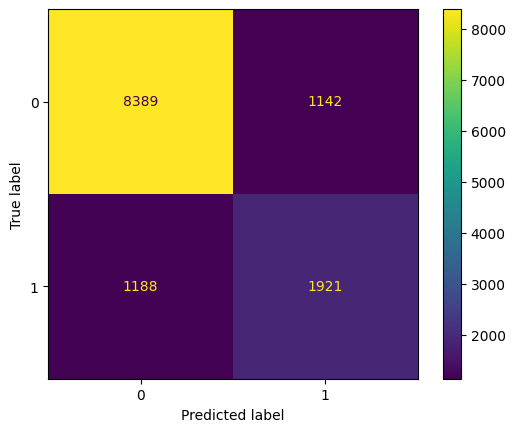

In [ ]:
from sklearn.metrics import ConfusionMatrixDisplay
fig=ConfusionMatrixDisplay(confusion_matrix=confusion_matrix(pred_dtc,y_test),display_labels=clf.classes_)
fig.plot()

#### Random forest

In [ ]:
from sklearn.ensemble import RandomForestClassifier
rfc = RandomForestClassifier(n_estimators=10,criterion='entropy',random_state=42)
rfc.fit(X_train,y_train)
pred_rfc = rfc.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

              precision    recall  f1-score   support

           0       0.88      0.89      0.88      9577
           1       0.64      0.63      0.63      3063

    accuracy                           0.82     12640
   macro avg       0.76      0.76      0.76     12640
weighted avg       0.82      0.82      0.82     12640

[[8500 1077]
 [1146 1917]]


In [ ]:
#find the best tree value
error_rate = []

for i in range(1,40):
    rfc = RandomForestClassifier(n_estimators=i,criterion='entropy',random_state=42)
    rfc.fit(X_train,y_train)
    pred_i = rfc.predict(X_test)
    error_rate.append(np.mean(pred_i != y_test))

Text(0, 0.5, 'Error Rate')

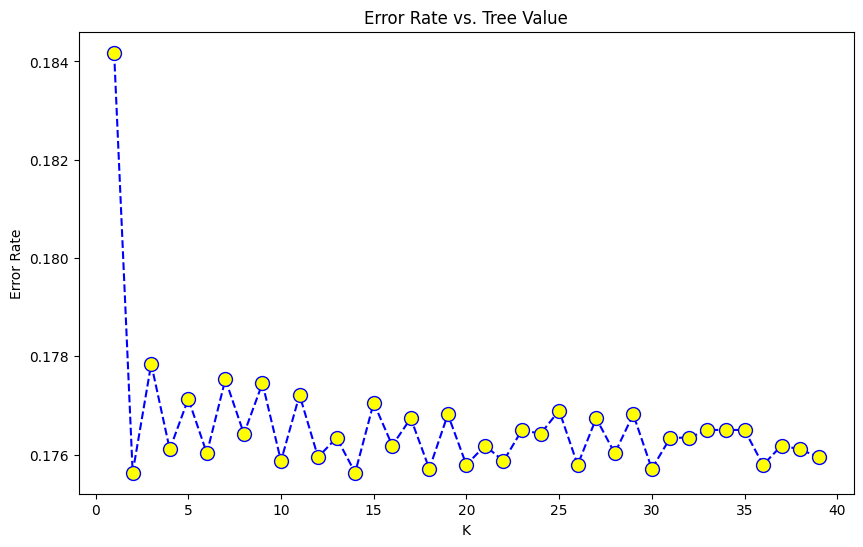

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10,6))
plt.plot(range(1,40),error_rate,color='blue', linestyle='dashed', marker='o',
         markerfacecolor='yellow', markersize=10)
plt.title('Error Rate vs. Tree Value')
plt.xlabel('K')
plt.ylabel('Error Rate') #error rate decrease as the tree value increases

In [ ]:
rfc = RandomForestClassifier(n_estimators=5,criterion='entropy',random_state=42) #12- trees from elbow method
rfc.fit(X_train,y_train)
pred_rfc= rfc.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

              precision    recall  f1-score   support

           0       0.88      0.88      0.88      9577
           1       0.63      0.64      0.64      3063

    accuracy                           0.82     12640
   macro avg       0.76      0.76      0.76     12640
weighted avg       0.82      0.82      0.82     12640

[[8452 1125]
 [1114 1949]]


#### Xgboost classifier

In [ ]:
from xgboost import XGBClassifier
classifier=XGBClassifier()
classifier.fit(X_train,y_train)
pred_xgb= classifier.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

              precision    recall  f1-score   support

           0       0.88      0.88      0.88      9577
           1       0.63      0.64      0.64      3063

    accuracy                           0.82     12640
   macro avg       0.76      0.76      0.76     12640
weighted avg       0.82      0.82      0.82     12640

[[8452 1125]
 [1114 1949]]


In [ ]:
from xgboost import XGBClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report, confusion_matrix

# Define the XGBoost classifier
classifier = XGBClassifier()

# Define the parameter grid for hyperparameter tuning
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [3, 5, 7],
    'learning_rate': [0.01, 0.05, 0.1]
}

# Perform grid search cross-validation
grid_search = GridSearchCV(estimator=classifier, param_grid=param_grid, cv=3, scoring='accuracy', verbose=2, n_jobs=-1)

# Fit the grid search to the data
grid_search.fit(X_train, y_train)

# Get the best model
best_classifier = grid_search.best_estimator_

# Make predictions with the best model
pred_xgb = best_classifier.predict(X_test)

# Print classification report and confusion matrix
print("Classification Report:")
print(classification_report(y_test, pred_xgb))
print("Confusion Matrix:")
print(confusion_matrix(y_test, pred_xgb))

# Print the best parameters found
print("Best Parameters:", grid_search.best_params_)


Fitting 3 folds for each of 27 candidates, totalling 81 fits
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.89      0.89      9577
           1       0.64      0.63      0.63      3063

    accuracy                           0.83     12640
   macro avg       0.76      0.76      0.76     12640
weighted avg       0.82      0.83      0.82     12640

Confusion Matrix:
[[8521 1056]
 [1148 1915]]
Best Parameters: {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 300}


#### Catboost classifier

In [ ]:
from catboost import CatBoostClassifier
classifier=CatBoostClassifier()
classifier.fit(X_train,y_train)
pred_xgb= classifier.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

Learning rate set to 0.043621
0:	learn: 0.5929404	total: 7.06ms	remaining: 7.05s
1:	learn: 0.5039357	total: 13.6ms	remaining: 6.79s
2:	learn: 0.4374395	total: 19.6ms	remaining: 6.5s
3:	learn: 0.3813992	total: 26.2ms	remaining: 6.51s
4:	learn: 0.3322885	total: 32.3ms	remaining: 6.42s
5:	learn: 0.2852208	total: 38.4ms	remaining: 6.36s
6:	learn: 0.2479440	total: 44.9ms	remaining: 6.36s
7:	learn: 0.2206046	total: 51.1ms	remaining: 6.34s
8:	learn: 0.1947514	total: 57.4ms	remaining: 6.32s
9:	learn: 0.1732044	total: 63.6ms	remaining: 6.3s
10:	learn: 0.1555279	total: 69.7ms	remaining: 6.27s
11:	learn: 0.1410851	total: 75.9ms	remaining: 6.25s
12:	learn: 0.1291312	total: 82ms	remaining: 6.22s
13:	learn: 0.1190860	total: 87.9ms	remaining: 6.19s
14:	learn: 0.1097885	total: 93.7ms	remaining: 6.15s
15:	learn: 0.1020929	total: 99.7ms	remaining: 6.13s
16:	learn: 0.0952055	total: 106ms	remaining: 6.1s
17:	learn: 0.0898680	total: 112ms	remaining: 6.09s
18:	learn: 0.0854676	total: 118ms	remaining: 6.07s


In [ ]:
from catboost import CatBoostClassifier
from sklearn.model_selection import GridSearchCV, StratifiedKFold
from sklearn.metrics import classification_report, confusion_matrix

# Define the CatBoost classifier
classifier = CatBoostClassifier()

# Define the parameter grid for hyperparameter tuning
param_grid = {
    'iterations': [100, 200],
    'depth': [3, 5],
    'learning_rate': [0.05, 0.1]
}

# Define stratified k-fold cross-validation
cv = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)

# Perform grid search cross-validation with early stopping
grid_search = GridSearchCV(estimator=classifier, param_grid=param_grid, cv=cv, scoring='accuracy', verbose=2, n_jobs=-1)

# Fit the grid search to the data with early stopping
grid_search.fit(X_train, y_train, early_stopping_rounds=10, eval_set=(X_test, y_test), verbose=False)

# Get the best model
best_classifier = grid_search.best_estimator_

# Make predictions with the best model
pred_catboost = best_classifier.predict(X_test)

# Print classification report and confusion matrix
print("Classification Report:")
print(classification_report(y_test, pred_catboost))
print("Confusion Matrix:")
print(confusion_matrix(y_test, pred_catboost))

# Print the best parameters found
print("Best Parameters:", grid_search.best_params_)


Fitting 3 folds for each of 8 candidates, totalling 24 fits
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.89      0.89      9577
           1       0.64      0.62      0.63      3063

    accuracy                           0.82     12640
   macro avg       0.76      0.75      0.76     12640
weighted avg       0.82      0.82      0.82     12640

Confusion Matrix:
[[8533 1044]
 [1169 1894]]
Best Parameters: {'depth': 5, 'iterations': 100, 'learning_rate': 0.05}


### Muril Ensemble models for tamil text

In [12]:
 #get the features vector and their labels (training set)
X_train,y_train=preprocess_dataset(train_df,
                                   model=muril_model,
                                   training=True,
                                   batch_size=128)

Processing Data: 100%|██████████| 231/231 [05:19<00:00,  1.38s/it]


In [13]:
#get the features vector and their labels (testing set)
X_test,y_test=preprocess_dataset(test_df,
                                 model=muril_model,
                                 training=False,
                                 batch_size=128)

Processing Data: 100%|██████████| 99/99 [02:21<00:00,  1.43s/it]


#### SVM

In [14]:
from sklearn.svm import SVC
from sklearn.metrics import classification_report, confusion_matrix
svm_classifier = SVC(kernel='rbf', random_state=42)
svm_classifier.fit(X_train, y_train)
pred_svm = svm_classifier.predict(X_test)
print(classification_report(y_test, pred_svm))
print(confusion_matrix(y_test, pred_svm))

              precision    recall  f1-score   support

           0       0.88      0.90      0.89      9577
           1       0.67      0.62      0.64      3063

    accuracy                           0.83     12640
   macro avg       0.78      0.76      0.77     12640
weighted avg       0.83      0.83      0.83     12640

[[8649  928]
 [1169 1894]]


#### Decision tree

In [15]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import classification_report,confusion_matrix
clf=DecisionTreeClassifier(criterion='entropy',random_state=42)
clf.fit(X_train,y_train)
pred_dtc=clf.predict(X_test)
print(classification_report(pred_dtc,y_test))
print(confusion_matrix(pred_dtc,y_test))

              precision    recall  f1-score   support

           0       0.90      0.88      0.89      9864
           1       0.60      0.66      0.63      2776

    accuracy                           0.83     12640
   macro avg       0.75      0.77      0.76     12640
weighted avg       0.84      0.83      0.83     12640

[[8642 1222]
 [ 935 1841]]


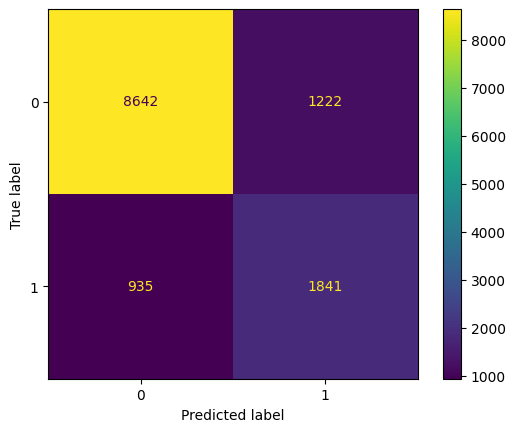

In [16]:
from sklearn.metrics import ConfusionMatrixDisplay
fig=ConfusionMatrixDisplay(confusion_matrix=confusion_matrix(pred_dtc,y_test),display_labels=clf.classes_)
fig.plot()

#### Random forest

In [17]:
from sklearn.ensemble import RandomForestClassifier
rfc = RandomForestClassifier(n_estimators=10,criterion='entropy',random_state=42)
rfc.fit(X_train,y_train)
pred_rfc = rfc.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

              precision    recall  f1-score   support

           0       0.88      0.90      0.89      9577
           1       0.67      0.60      0.63      3063

    accuracy                           0.83     12640
   macro avg       0.77      0.75      0.76     12640
weighted avg       0.83      0.83      0.83     12640

[[8661  916]
 [1214 1849]]


In [18]:
#find the best tree value
error_rate = []

for i in range(1,40):
    rfc = RandomForestClassifier(n_estimators=i,criterion='entropy',random_state=42)
    rfc.fit(X_train,y_train)
    pred_i = rfc.predict(X_test)
    error_rate.append(np.mean(pred_i != y_test))

Text(0, 0.5, 'Error Rate')

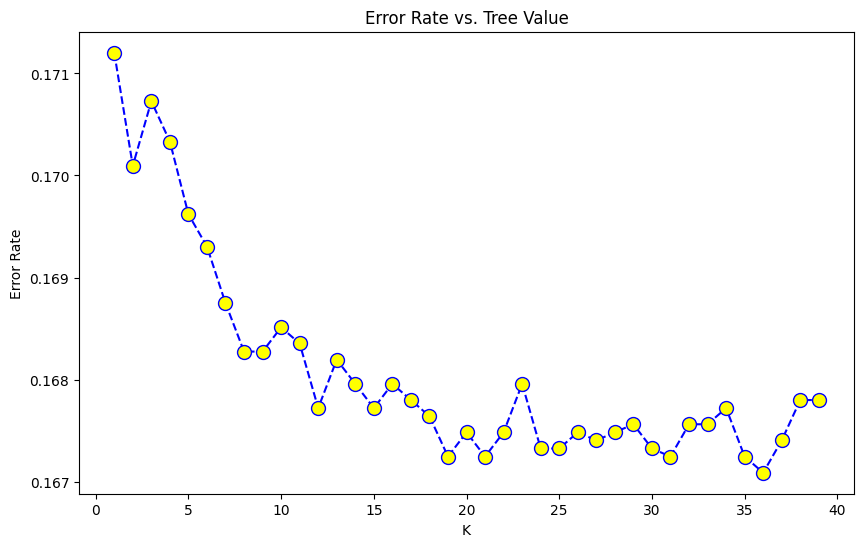

In [19]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10,6))
plt.plot(range(1,40),error_rate,color='blue', linestyle='dashed', marker='o',
         markerfacecolor='yellow', markersize=10)
plt.title('Error Rate vs. Tree Value')
plt.xlabel('K')
plt.ylabel('Error Rate') #error rate decrease as the tree value increases

In [20]:
rfc = RandomForestClassifier(n_estimators=5,criterion='entropy',random_state=42) #12- trees from elbow method
rfc.fit(X_train,y_train)
pred_rfc= rfc.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

              precision    recall  f1-score   support

           0       0.88      0.90      0.89      9577
           1       0.66      0.61      0.64      3063

    accuracy                           0.83     12640
   macro avg       0.77      0.76      0.76     12640
weighted avg       0.83      0.83      0.83     12640

[[8622  955]
 [1189 1874]]


#### Xgboost classifier

In [21]:
from xgboost import XGBClassifier
classifier=XGBClassifier()
classifier.fit(X_train,y_train)
pred_xgb= classifier.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

              precision    recall  f1-score   support

           0       0.88      0.90      0.89      9577
           1       0.66      0.61      0.64      3063

    accuracy                           0.83     12640
   macro avg       0.77      0.76      0.76     12640
weighted avg       0.83      0.83      0.83     12640

[[8622  955]
 [1189 1874]]


In [22]:
from xgboost import XGBClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report, confusion_matrix

# Define the XGBoost classifier
classifier = XGBClassifier()

# Define the parameter grid for hyperparameter tuning
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [3, 5, 7],
    'learning_rate': [0.01, 0.05, 0.1]
}

# Perform grid search cross-validation
grid_search = GridSearchCV(estimator=classifier, param_grid=param_grid, cv=3, scoring='accuracy', verbose=2, n_jobs=-1)

# Fit the grid search to the data
grid_search.fit(X_train, y_train)

# Get the best model
best_classifier = grid_search.best_estimator_

# Make predictions with the best model
pred_xgb = best_classifier.predict(X_test)

# Print classification report and confusion matrix
print("Classification Report:")
print(classification_report(y_test, pred_xgb))
print("Confusion Matrix:")
print(confusion_matrix(y_test, pred_xgb))

# Print the best parameters found
print("Best Parameters:", grid_search.best_params_)


Fitting 3 folds for each of 27 candidates, totalling 81 fits
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.91      0.89      9577
           1       0.69      0.60      0.64      3063

    accuracy                           0.84     12640
   macro avg       0.78      0.75      0.77     12640
weighted avg       0.83      0.84      0.83     12640

Confusion Matrix:
[[8761  816]
 [1240 1823]]
Best Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 100}


#### Catboost classifier

In [23]:
from catboost import CatBoostClassifier
classifier=CatBoostClassifier()
classifier.fit(X_train,y_train)
pred_xgb= classifier.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

Learning rate set to 0.043621
0:	learn: 0.5914083	total: 54.4ms	remaining: 54.3s
1:	learn: 0.5074738	total: 60.9ms	remaining: 30.4s
2:	learn: 0.4355388	total: 67.4ms	remaining: 22.4s
3:	learn: 0.3761312	total: 78ms	remaining: 19.4s
4:	learn: 0.3257057	total: 84.4ms	remaining: 16.8s
5:	learn: 0.2833935	total: 91.1ms	remaining: 15.1s
6:	learn: 0.2477908	total: 97.5ms	remaining: 13.8s
7:	learn: 0.2181709	total: 104ms	remaining: 12.9s
8:	learn: 0.1942028	total: 110ms	remaining: 12.1s
9:	learn: 0.1729614	total: 118ms	remaining: 11.7s
10:	learn: 0.1547753	total: 124ms	remaining: 11.2s
11:	learn: 0.1403055	total: 131ms	remaining: 10.8s
12:	learn: 0.1279138	total: 138ms	remaining: 10.4s
13:	learn: 0.1174315	total: 144ms	remaining: 10.1s
14:	learn: 0.1085713	total: 151ms	remaining: 9.88s
15:	learn: 0.1008885	total: 159ms	remaining: 9.75s
16:	learn: 0.0940971	total: 164ms	remaining: 9.48s
17:	learn: 0.0885835	total: 170ms	remaining: 9.28s
18:	learn: 0.0833049	total: 177ms	remaining: 9.12s
19:	le

In [24]:
from catboost import CatBoostClassifier
from sklearn.model_selection import GridSearchCV, StratifiedKFold
from sklearn.metrics import classification_report, confusion_matrix

# Define the CatBoost classifier
classifier = CatBoostClassifier()

# Define the parameter grid for hyperparameter tuning
param_grid = {
    'iterations': [100, 200],
    'depth': [3, 5],
    'learning_rate': [0.05, 0.1]
}

# Define stratified k-fold cross-validation
cv = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)

# Perform grid search cross-validation with early stopping
grid_search = GridSearchCV(estimator=classifier, param_grid=param_grid, cv=cv, scoring='accuracy', verbose=2, n_jobs=-1)

# Fit the grid search to the data with early stopping
grid_search.fit(X_train, y_train, early_stopping_rounds=10, eval_set=(X_test, y_test), verbose=False)

# Get the best model
best_classifier = grid_search.best_estimator_

# Make predictions with the best model
pred_catboost = best_classifier.predict(X_test)

# Print classification report and confusion matrix
print("Classification Report:")
print(classification_report(y_test, pred_catboost))
print("Confusion Matrix:")
print(confusion_matrix(y_test, pred_catboost))

# Print the best parameters found
print("Best Parameters:", grid_search.best_params_)


Fitting 3 folds for each of 8 candidates, totalling 24 fits
Classification Report:
              precision    recall  f1-score   support

           0       0.89      0.88      0.89      9577
           1       0.64      0.67      0.66      3063

    accuracy                           0.83     12640
   macro avg       0.77      0.77      0.77     12640
weighted avg       0.83      0.83      0.83     12640

Confusion Matrix:
[[8451 1126]
 [1020 2043]]
Best Parameters: {'depth': 3, 'iterations': 200, 'learning_rate': 0.1}


### Tamillion Ensemble models for tamil text

In [ ]:
 #get the features vector and their labels (training set)
X_train,y_train=preprocess_dataset(train_df,
                                   model=tamillion_model,
                                   training=True,
                                   batch_size=128)

Processing Data: 100%|██████████| 231/231 [05:02<00:00,  1.31s/it]


In [ ]:
#get the features vector and their labels (testing set)
X_test,y_test=preprocess_dataset(test_df,
                                 model=tamillion_model,
                                 training=False,
                                 batch_size=128)

Processing Data: 100%|██████████| 99/99 [02:11<00:00,  1.33s/it]


#### SVM

In [ ]:
from sklearn.svm import SVC
from sklearn.metrics import classification_report, confusion_matrix
svm_classifier = SVC(kernel='rbf', random_state=42)
svm_classifier.fit(X_train, y_train)
pred_svm = svm_classifier.predict(X_test)
print(classification_report(y_test, pred_svm))
print(confusion_matrix(y_test, pred_svm))

              precision    recall  f1-score   support

           0       0.86      0.89      0.88      9577
           1       0.62      0.55      0.58      3063

    accuracy                           0.81     12640
   macro avg       0.74      0.72      0.73     12640
weighted avg       0.80      0.81      0.80     12640

[[8532 1045]
 [1376 1687]]


#### Decision tree

In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import classification_report,confusion_matrix
clf=DecisionTreeClassifier(criterion='entropy',random_state=42)
clf.fit(X_train,y_train)
pred_dtc=clf.predict(X_test)
print(classification_report(pred_dtc,y_test))
print(confusion_matrix(pred_dtc,y_test))

              precision    recall  f1-score   support

           0       0.86      0.86      0.86      9613
           1       0.55      0.56      0.55      3027

    accuracy                           0.78     12640
   macro avg       0.70      0.71      0.70     12640
weighted avg       0.78      0.78      0.78     12640

[[8230 1383]
 [1347 1680]]


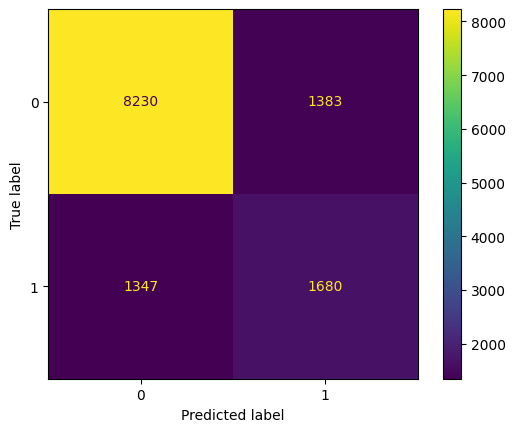

In [ ]:
from sklearn.metrics import ConfusionMatrixDisplay
fig=ConfusionMatrixDisplay(confusion_matrix=confusion_matrix(pred_dtc,y_test),display_labels=clf.classes_)
fig.plot()

#### Random forest

In [ ]:
from sklearn.ensemble import RandomForestClassifier
rfc = RandomForestClassifier(n_estimators=10,criterion='entropy',random_state=42)
rfc.fit(X_train,y_train)
pred_rfc = rfc.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

              precision    recall  f1-score   support

           0       0.86      0.89      0.87      9577
           1       0.60      0.54      0.57      3063

    accuracy                           0.80     12640
   macro avg       0.73      0.71      0.72     12640
weighted avg       0.79      0.80      0.80     12640

[[8495 1082]
 [1424 1639]]


In [ ]:
#find the best tree value
error_rate = []

for i in range(1,40):
    rfc = RandomForestClassifier(n_estimators=i,criterion='entropy',random_state=42)
    rfc.fit(X_train,y_train)
    pred_i = rfc.predict(X_test)
    error_rate.append(np.mean(pred_i != y_test))

Text(0, 0.5, 'Error Rate')

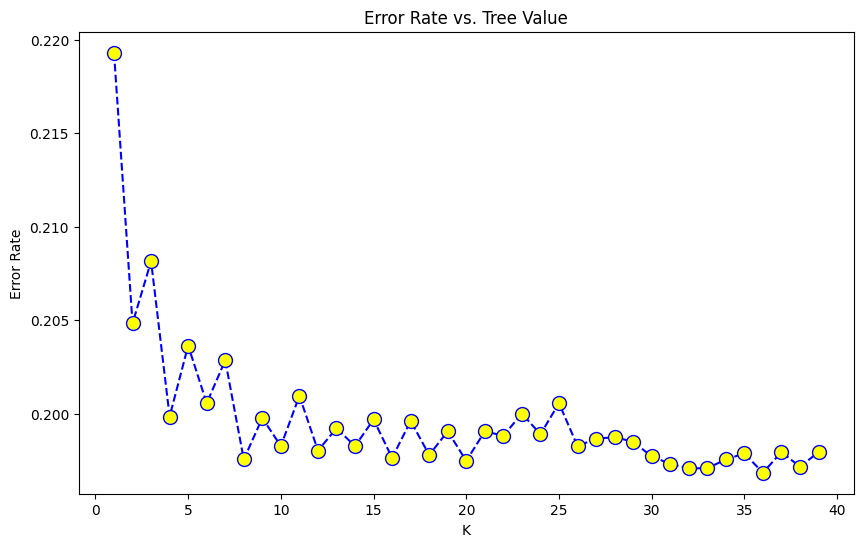

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10,6))
plt.plot(range(1,40),error_rate,color='blue', linestyle='dashed', marker='o',
         markerfacecolor='yellow', markersize=10)
plt.title('Error Rate vs. Tree Value')
plt.xlabel('K')
plt.ylabel('Error Rate') #error rate decrease as the tree value increases

In [ ]:
rfc = RandomForestClassifier(n_estimators=5,criterion='entropy',random_state=42) #12- trees from elbow method
rfc.fit(X_train,y_train)
pred_rfc= rfc.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

              precision    recall  f1-score   support

           0       0.86      0.87      0.87      9577
           1       0.58      0.56      0.57      3063

    accuracy                           0.80     12640
   macro avg       0.72      0.71      0.72     12640
weighted avg       0.79      0.80      0.79     12640

[[8366 1211]
 [1363 1700]]


#### Xgboost classifier

In [ ]:
from xgboost import XGBClassifier
classifier=XGBClassifier()
classifier.fit(X_train,y_train)
pred_xgb= classifier.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

              precision    recall  f1-score   support

           0       0.86      0.87      0.87      9577
           1       0.58      0.56      0.57      3063

    accuracy                           0.80     12640
   macro avg       0.72      0.71      0.72     12640
weighted avg       0.79      0.80      0.79     12640

[[8366 1211]
 [1363 1700]]


In [ ]:
from xgboost import XGBClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report, confusion_matrix

# Define the XGBoost classifier
classifier = XGBClassifier()

# Define the parameter grid for hyperparameter tuning
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [3, 5, 7],
    'learning_rate': [0.01, 0.05, 0.1]
}

# Perform grid search cross-validation
grid_search = GridSearchCV(estimator=classifier, param_grid=param_grid, cv=3, scoring='accuracy', verbose=2, n_jobs=-1)

# Fit the grid search to the data
grid_search.fit(X_train, y_train)

# Get the best model
best_classifier = grid_search.best_estimator_

# Make predictions with the best model
pred_xgb = best_classifier.predict(X_test)

# Print classification report and confusion matrix
print("Classification Report:")
print(classification_report(y_test, pred_xgb))
print("Confusion Matrix:")
print(confusion_matrix(y_test, pred_xgb))

# Print the best parameters found
print("Best Parameters:", grid_search.best_params_)


Fitting 3 folds for each of 27 candidates, totalling 81 fits
Classification Report:
              precision    recall  f1-score   support

           0       0.86      0.89      0.88      9577
           1       0.62      0.55      0.58      3063

    accuracy                           0.81     12640
   macro avg       0.74      0.72      0.73     12640
weighted avg       0.80      0.81      0.80     12640

Confusion Matrix:
[[8531 1046]
 [1377 1686]]
Best Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 300}


#### Catboost classifier

In [ ]:
from catboost import CatBoostClassifier
classifier=CatBoostClassifier()
classifier.fit(X_train,y_train)
pred_xgb= classifier.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

Learning rate set to 0.043621
0:	learn: 0.6329936	total: 17.8ms	remaining: 17.8s
1:	learn: 0.5808553	total: 27.4ms	remaining: 13.7s
2:	learn: 0.5365580	total: 33.7ms	remaining: 11.2s
3:	learn: 0.4967887	total: 44ms	remaining: 11s
4:	learn: 0.4629068	total: 57ms	remaining: 11.3s
5:	learn: 0.4345365	total: 66.7ms	remaining: 11.1s
6:	learn: 0.4091463	total: 84.6ms	remaining: 12s
7:	learn: 0.3882668	total: 102ms	remaining: 12.7s
8:	learn: 0.3690013	total: 120ms	remaining: 13.3s
9:	learn: 0.3521716	total: 137ms	remaining: 13.6s
10:	learn: 0.3380944	total: 153ms	remaining: 13.8s
11:	learn: 0.3252743	total: 168ms	remaining: 13.8s
12:	learn: 0.3137618	total: 183ms	remaining: 13.9s
13:	learn: 0.3039976	total: 202ms	remaining: 14.2s
14:	learn: 0.2951400	total: 219ms	remaining: 14.4s
15:	learn: 0.2885296	total: 238ms	remaining: 14.6s
16:	learn: 0.2818022	total: 255ms	remaining: 14.8s
17:	learn: 0.2752815	total: 271ms	remaining: 14.8s
18:	learn: 0.2697272	total: 290ms	remaining: 15s
19:	learn: 0.2

In [ ]:
from catboost import CatBoostClassifier
from sklearn.model_selection import GridSearchCV, StratifiedKFold
from sklearn.metrics import classification_report, confusion_matrix

# Define the CatBoost classifier
classifier = CatBoostClassifier()

# Define the parameter grid for hyperparameter tuning
param_grid = {
    'iterations': [100, 200],
    'depth': [3, 5],
    'learning_rate': [0.05, 0.1]
}

# Define stratified k-fold cross-validation
cv = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)

# Perform grid search cross-validation with early stopping
grid_search = GridSearchCV(estimator=classifier, param_grid=param_grid, cv=cv, scoring='accuracy', verbose=2, n_jobs=-1)

# Fit the grid search to the data with early stopping
grid_search.fit(X_train, y_train, early_stopping_rounds=10, eval_set=(X_test, y_test), verbose=False)

# Get the best model
best_classifier = grid_search.best_estimator_

# Make predictions with the best model
pred_catboost = best_classifier.predict(X_test)

# Print classification report and confusion matrix
print("Classification Report:")
print(classification_report(y_test, pred_catboost))
print("Confusion Matrix:")
print(confusion_matrix(y_test, pred_catboost))

# Print the best parameters found
print("Best Parameters:", grid_search.best_params_)


Fitting 3 folds for each of 8 candidates, totalling 24 fits
Classification Report:
              precision    recall  f1-score   support

           0       0.86      0.88      0.87      9577
           1       0.61      0.56      0.58      3063

    accuracy                           0.81     12640
   macro avg       0.73      0.72      0.73     12640
weighted avg       0.80      0.81      0.80     12640

Confusion Matrix:
[[8460 1117]
 [1341 1722]]
Best Parameters: {'depth': 3, 'iterations': 100, 'learning_rate': 0.05}
